# Lista de Features Disponíveis Após Processar o DataFrame Volve

Esta seção descreve as features disponíveis no DataFrame utilizado no modelo de previsão. Cada feature desempenha um papel importante na análise e modelagem dos dados de produção. 

| **Feature**               | **Descrição**                                                                                         |
|---------------------------|-----------------------------------------------------------------------------------------------------|
| **BORE_GAS_VOL**          | Volume de gás produzido no poço, medido em uma unidade específica (normalmente SCF ou m³).         |
| **CE**                    | Coeficiente Energético (CE), que pode representar uma métrica de eficiência de produção.           |
| **AVG_DOWNHOLE_PRESSURE** | Pressão média no fundo do poço (Downhole), geralmente medida em psi ou bar.                        |
| **delta_P**               | Variação de pressão entre dois pontos, indicando perdas de carga ou mudanças na operação.          |
| **Tempo_Inicio_Prod**     | Tempo desde o início da produção, em horas ou dias, útil para análise de performance ao longo do tempo. |
| **PI**                    | Índice de produtividade do poço (Productivity Index), relaciona a produção à pressão.             |
| **AVG_WHP_P**             | Pressão média na cabeça do poço (Wellhead Pressure), uma métrica operacional.                     |
| **BORE_WAT_VOL**          | Volume de água produzido no poço, útil para análise de eficiência e problemas de produção.         |
| **AVG_CHOKE_SIZE_P**      | Tamanho médio da válvula de estrangulamento (Choke Size), controlando o fluxo de produção.         |
| **BORE_WI_VOL_15_9_F_4**  | Volume de injeção de água no poço, medido em uma unidade específica (SCF ou m³).                  |
| **ON_STREAM_HRS**         | Horas em que o poço esteve em produção (tempo de operação).                                        |
| **Taxa_Declinio**         | Taxa de declínio da produção ao longo do tempo, importante para previsão de longo prazo.           |
| **BORE_OIL_VOL_Original** | Volume original de óleo produzido no poço, útil para comparar com volumes cumulativos atuais.      |

### Observações:
1. As unidades de medida variam de acordo com os dados, então é importante garantir consistência antes de usar as features para modelagem.
2. Algumas features como **delta_P**, **Taxa_Declinio** e **PI** podem ser derivadas ou calculadas a partir de outros parâmetros.

In [1]:
import os
import glob
import json
import logging
import copy
import time
from itertools import combinations
from concurrent.futures import ProcessPoolExecutor, as_completed

import numpy as np
import pandas as pd
from tensorflow.keras.layers import Dense


# -------------------------------------------------------------------
# Import common modules from the project
# -------------------------------------------------------------------
from data.data_loading import DataSource
from data.data_preparation import apply_custom_kalman_filter
from common.batch_preprocessing import (load_and_preprocess_data,
                                            prepare_data,
                                            prepare_inputs,
                                            prepare_datasets, 
                                            scale_and_reshape_data,
                                            prepare_normal_inputs, 
                                            prepare_branch_inputs)

from evaluation.evaluation import evaluate_model, evaluate_cumulative, display_metrics, compute_metrics_to_df, display_data_overview
from training.train_models import main_train_model
from common.config_wells import DATA_SOURCES
from utils.utilities import clean_checkpoint_files, generate_jobs, print_style

2025-05-13 10:15:35.826661: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-05-13 10:15:35.826686: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-05-13 10:15:35.827356: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-05-13 10:15:35.831254: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-13 10:15:36.436430: W tensorflow/compiler/tf2

 ____                 _ _      _   _____                     _   _             
|  _ \ __ _ _ __ __ _| | | ___| | | ____|_  _____  ___ _   _| |_(_) ___  _ __  
| |_) / _` | '__/ _` | | |/ _ \ | |  _| \ \/ / _ \/ __| | | | __| |/ _ \| '_ \ 
|  __/ (_| | | | (_| | | |  __/ | | |___ >  <  __/ (__| |_| | |_| | (_) | | | |
|_|   \__,_|_|  \__,_|_|_|\___|_| |_____/_/\_\___|\___|\__,_|\__|_|\___/|_| |_|
                                                                               


[Experiment #1] Data source: VOLVE, Well: 15/9-F-14
Architecture: Seq2Value, Feature kind: Normal
Selected features: ['PI', 'BORE_GAS_VOL', 'BORE_OIL_VOL']
NaNs and infinite values before imputation
Col: AVG_DOWNHOLE_PRESSURE NaN: 6
Col: AVG_DOWNHOLE_PRESSURE InF: 0
Col: Taxa_Declinio NaN: 1
Col: Taxa_Declinio InF: 0
Col: delta_P NaN: 6
Col: delta_P InF: 0
Col: PI NaN: 6
Col: PI InF: 0
NaNs and infinite values after imputation
Col: AVG_DOWNHOLE_PRESSURE NaN: 0
Col: AVG_DOWNHOLE_PRESSURE InF: 0
Col: Taxa_Declinio NaN: 0
Col: Taxa_Declinio InF: 0
Col: delta_P NaN: 0
Col: delta_P InF: 0
Col: PI NaN: 0
Col: PI InF: 0
df_train.shape, df_test.shape (1075, 11) (1612, 11)


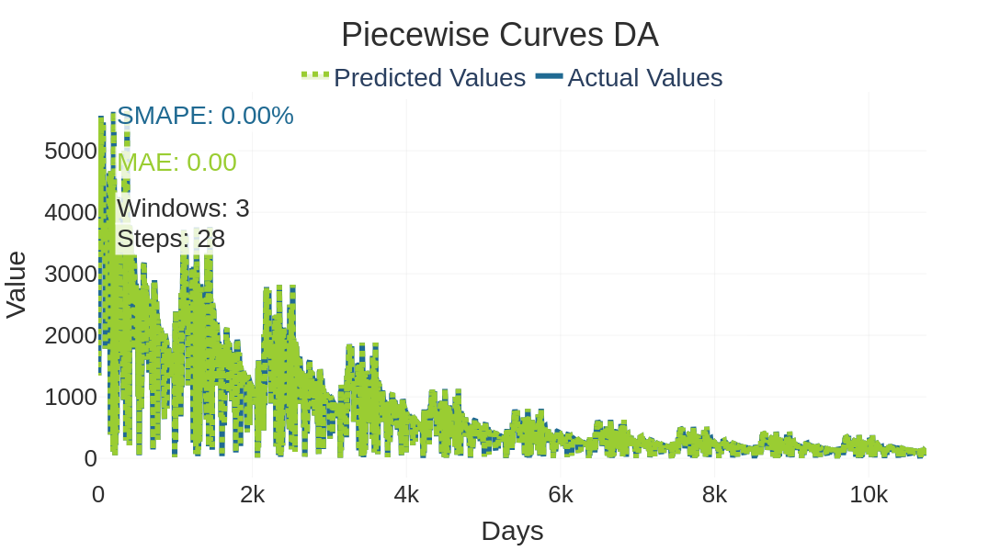

,Set,X Shape,y Shape,Samples,Data Format,Proportion
0,Training,"(10750, 1, 9)","(10750,)",10750,ndarray,86.96 %
1,Testing,"(1612, 1, 9)","(1612,)",1612,ndarray,13.04 %



[Experiment #1] Training model 1/5...


2025-05-13 10:19:09.295767: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-05-13 10:19:09.316899: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2256] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Best Val Loss: 0.1901
51/51 [==============================] - 0s 928us/step

[Experiment #1] Training model 2/5...
Best Val Loss: 0.1873
51/51 [==============================] - 0s 868us/step

[Experiment #1] Training model 3/5...
Best Val Loss: 0.1646
51/51 [==============================] - 0s 932us/step

[Experiment #1] Training model 4/5...
Best Val Loss: 0.1941
51/51 [==============================] - 0s 954us/step

[Experiment #1] Training model 5/5...
Best Val Loss: 0.1942
51/51 [==============================] - 0s 911us/step

[Experiment #1] Evaluating ensemble predictions...
R² on the test set: 0.8048
SMAPE on the test set: 16.3182
MAE on the test set: 95.1944


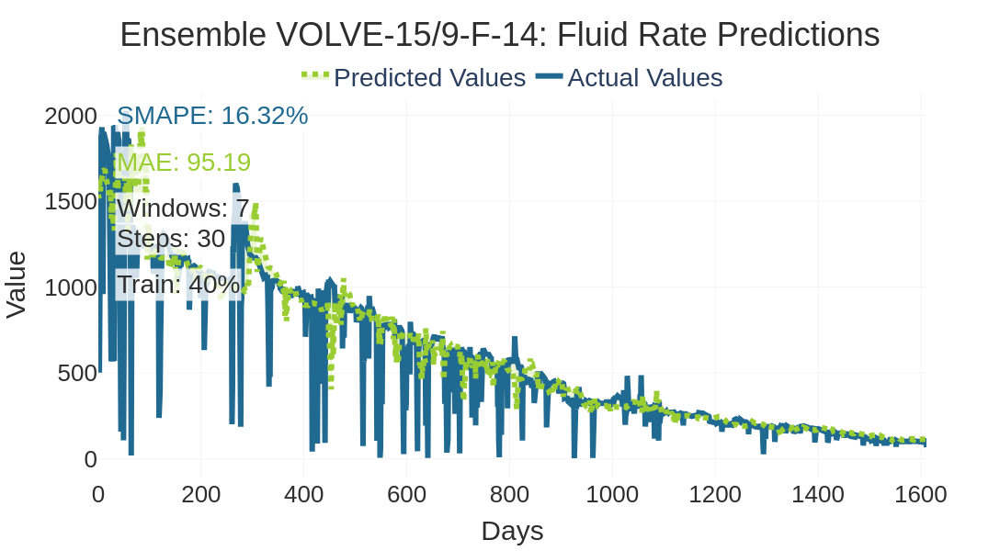

R² on the test set: 0.9877
SMAPE on the test set: 0.7698
MAE on the test set: 27934.7596


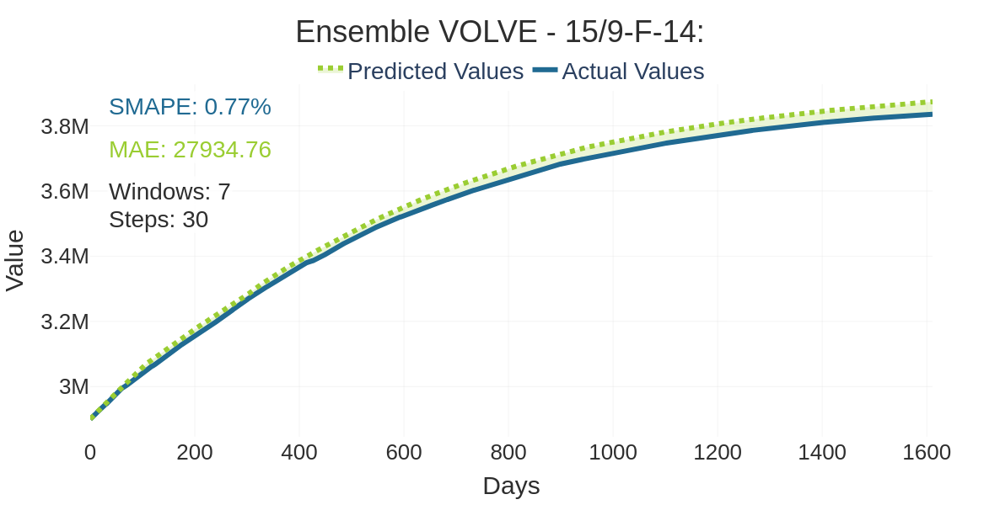

R² on the test set: 0.8048
SMAPE on the test set: 16.3182%
MAE on the test set: 95.1944
R² on the test set: 0.9877
SMAPE on the test set: 0.7698%
MAE on the test set: 27934.7596

[Experiment #1] Completed for Data source: VOLVE, Well: 15/9-F-14


Displaying Regular Metrics:


,R²,SMAPE,MAE
0,0.8048,16.32%,95.1944



Displaying Cumulative Metrics:


,R²,SMAPE,MAE
0,0.9877,0.77%,27934.7596


In [4]:
# Experiment class encapsulating a full experiment run
class Experiment:
    def __init__(self, config, well, params, exp_id):
        self.config = config
        self.well = well
        self.params = params
        self.exp_id = exp_id

    def get_features(self):
        # Determine main and selected features
        main_feature = self.config.get("target_column", self.config["load_params"].get("serie_name"))
        selected_features = self.params.get("selected_features", self.config.get("features", [main_feature]))
        if self.params.get("use_known_good", False):
            selected_features = ['BORE_GAS_VOL', 'CE', 'PI', 'BORE_OIL_VOL_Original', main_feature]
        return main_feature, selected_features

    def get_params(self):
        # Extract and return experiment parameters with defaults
        return {
            "lag_window": self.params.get("lag_window", 7),
            "horizon": self.params.get("horizon", 30),
            "epochs": self.params.get("epochs", 50),
            "batch_size": self.params.get("batch_size", 64),
            "patience": self.params.get("patience", 100),
            "test_size": self.params.get("test_size", 0.6),
            "ensemble_models": self.params.get("ensemble_models", 1),
            "feature_kind": self.params.get("feature_kind", 'Branch'),
            "architecture_name": self.params.get("architecture_name", 'Hybrid Pool')
        }

    def train_ensemble(self, architecture_name, feature_kind, train_kwargs, prediction_input, epochs, batch_size, patience, ensemble_models):
        # Train multiple models and collect their predictions
        predictions = []
        for i in range(ensemble_models):
            print(f"\n[Experiment #{self.exp_id}] Training model {i+1}/{ensemble_models}...")
            model, history = main_train_model(architecture_name, feature_kind, train_kwargs, prediction_input, epochs, batch_size, patience)
            predictions.append(model.predict(prediction_input).flatten())
            # self.analyze_trend_branch_contribution(model)
        return predictions
    
    def analyze_trend_branch_contribution(self, model, verbose=True):
        """
        Analyzes and prints the contribution of trend and branch components
        to the final forecast by examining the Dense layer after concatenation.

        Parameters:
        - model: Keras model instance.
        - horizon: Output horizon length (int).
        - verbose: If True, prints the results.

        Returns:
        - trend_percentage, branch_percentage
        """
        dense_layer = None

        # Step 1: Safely find the correct Dense layer
        for layer in reversed(model.layers):
            try:
                weights = layer.get_weights()
                if isinstance(layer, Dense) and len(weights) == 2:
                    dense_layer = layer
                    break
 
                    
            except:
                continue

        if dense_layer is None:
            raise ValueError("No suitable Dense layer found to extract forecast weights.")

        # Step 2: Extract and analyze the weights
        dense_weights, dense_bias = dense_layer.get_weights()

        if dense_weights.shape[0] != 2:
            raise ValueError(f"Expected weight shape [2*horizon, horizon], got {dense_weights.shape}")

        trend_weights = dense_weights[:1, :]
        branch_weights = dense_weights[1:, :]

        trend_contrib = np.mean(np.abs(trend_weights))
        branch_contrib = np.mean(np.abs(branch_weights))

        total_contrib = trend_contrib + branch_contrib
        trend_percentage = trend_contrib / total_contrib * 100
        branch_percentage = branch_contrib / total_contrib * 100

        if verbose:
            print(f"Trend contribution: {trend_percentage:.2f}%")
            print(f"branch contribution: {branch_percentage:.2f}%")
            print(f"Analyzed Dense layer: {dense_layer.name}")

    def run(self):
        try:
            # 1. Get features and parameters for the experiment
            main_feature, selected_features = self.get_features()
            params = self.get_params()
            lag_window = params["lag_window"]
            horizon = params["horizon"]
            epochs = params["epochs"]
            batch_size = params["batch_size"]
            patience = params["patience"]
            test_size = params["test_size"]
            ensemble_models = params["ensemble_models"]
            feature_kind = params["feature_kind"]
            architecture_name = params["architecture_name"]
            
            train_size = 1-test_size

            # Print experiment header
            header = f"\n[Experiment #{self.exp_id}] Data source: {self.config['name']}, Well: {self.well}"
            print(header)
            print(f"Architecture: {architecture_name}, Feature kind: {feature_kind}")
            print(f"Selected features: {selected_features}")

            # 2. Load and preprocess data
            df_subset = load_and_preprocess_data(DataSource, self.config, selected_features, self.well)
            
            X_train_scaled, X_test_scaled, y_train_scaled, y_test_scaled, scaler_y, y_train_cumsum = prepare_data(
                df_subset, main_feature, lag_window, horizon, test_size, data_aug=True
            )
                        
            display_data_overview(X_train_scaled, X_test_scaled, y_train_scaled, y_test_scaled, theme="surrealist")
            
            train_kwargs, prediction_input = prepare_inputs(
                X_train_scaled, X_test_scaled, y_train_scaled, y_test_scaled,
                feature_kind, selected_features, main_feature
            )

            # 3. Train ensemble models
            model_predictions = self.train_ensemble(architecture_name, feature_kind, train_kwargs, prediction_input, epochs, batch_size, patience, ensemble_models)

            # 4. Aggregate predictions (average if ensemble, or single prediction)
            final_prediction = np.mean(np.array(model_predictions), axis=0) if ensemble_models > 1 else model_predictions[0]
            print(f"\n[Experiment #{self.exp_id}] Evaluating ensemble predictions...")

            # 5. Evaluate standard predictions
            y_test_inv, y_ensemble_inv = evaluate_model(
                y_test_scaled, final_prediction, scaler_y,
                lag_window, horizon, train_size, self.config,
                eval_title="",
                set_name=f"Ensemble {self.config['name']}-{self.well}: Fluid Rate Predictions"
            )
            # 6. Evaluate cumulative predictions
            y_test_inv_cum, y_ensemble_inv_cum = evaluate_cumulative(
                y_test_inv, y_ensemble_inv, y_train_cumsum,
                lag_window, horizon, self.config,
                set_name=f"Ensemble {self.config['name']} - {self.well}:"
            )

            # 7. Compute evaluation metrics
            metrics_regular = compute_metrics_to_df(
                y_test=y_test_inv,
                y_pred=y_ensemble_inv,
                well=self.well,
                method=architecture_name,
                metric_type="Series"
            )
            metrics_cumulative = compute_metrics_to_df(
                y_test=y_test_inv_cum,
                y_pred=y_ensemble_inv_cum,
                well=self.well,
                method=architecture_name,
                metric_type="Series"
            )

            print(f"\n[Experiment #{self.exp_id}] Completed for Data source: {self.config['name']}, Well: {self.well}\n")
            return {
                "metrics_regular": metrics_regular,
                "metrics_cumulative": metrics_cumulative,
                "status": "success"
            }
        except Exception as e:
            logging.exception(f"Experiment #{self.exp_id} failed for data source: {self.config['name']}, well: {self.well}")
            return {
                "data_source": self.config["name"],
                "well": self.well,
                "experiment": self.params,
                "experiment_id": self.exp_id,
                "error": str(e),
                "status": "failure"
            }


# Main pipeline to run experiments
def main(ensemble_models=1, selected_names=None):
    # Clean checkpoint files and set up logging
    clean_checkpoint_files("model_checkpoint")
    logging.basicConfig(level=logging.INFO, format="%(asctime)s - %(levelname)s - %(message)s")

    if selected_names is None:
        selected_names = [ds["name"] for ds in DATA_SOURCES]

    filtered_data_sources = [ds for ds in DATA_SOURCES if ds["name"] in selected_names]

    # Define experiment configurations for each data source
    volve_experiments = [
        {
            "architecture_name": "Seq2Value",
            "feature_kind": "Normal",
            "selected_features": ['PI', 'BORE_GAS_VOL', 'BORE_OIL_VOL'],
            "ensemble_models": ensemble_models,
            "use_known_good": False
        },
    ]
    unisim_experiments = [
        {
            "architecture_name": "Seq2Value",
            "feature_kind": "Normal",
            "selected_features": ['QLOB', 'QGOB', 'QOOB'],
            "ensemble_models": ensemble_models,
            "use_known_good": False
        }
    ]
    opsd_experiments = [
        {
            "architecture_name": "Seq2Value",
            "feature_kind": "Normal",
            "selected_features": ['GB_GBN_wind_generation_tax', 'GB_GBN_wind_generation_actual'],
            "ensemble_models": ensemble_models,
            "use_known_good": False
        }
    ]

    experiment_configurations = {
        "OPSD": opsd_experiments,
        "VOLVE": volve_experiments,
        "UNISIM": unisim_experiments,
    }

    jobs = []
    experiment_counter = 1
    # Create jobs for each data source, well, and experiment configuration
    for ds in filtered_data_sources:
        ds_experiments = experiment_configurations.get(ds["name"], [])
        for well in ds["wells"]:
            for exp_params in ds_experiments:
                jobs.append((ds, well, exp_params, experiment_counter))
                experiment_counter += 1

    results = []
    sequential_mode = False  # ou False para rodar em paralelo

    if sequential_mode:
        print_style('Sequential Execution')
        for job in jobs:
            try:
                result = Experiment(*job).run()
                results.append(result)
            except Exception as exc:
                logging.error(f"Job {job} generated an exception: {exc}")
    else:
        print_style('Parallel Execution')
        with ProcessPoolExecutor(max_workers=min(4, len(jobs))) as executor:
            future_to_job = {executor.submit(Experiment(*job).run): job for job in jobs}
            for future in as_completed(future_to_job):
                job_info = future_to_job[future]
                try:
                    results.append(future.result())
                except Exception as exc:
                    logging.error(f"Job {job_info} generated an exception: {exc}")


    # Accumulate metrics from successful experiments
    metrics_accumulator_regular = []
    metrics_accumulator_cum = []
    for res in results:
        if res.get("status") == "success":
            if res.get("metrics_regular"):
                metrics_accumulator_regular.append(res["metrics_regular"])
            if res.get("metrics_cumulative"):
                metrics_accumulator_cum.append(res["metrics_cumulative"])

    print("\nDisplaying Regular Metrics:")
    display_metrics(metrics_accumulator_regular)

    print("\nDisplaying Cumulative Metrics:")
    display_metrics(metrics_accumulator_cum)


if __name__ == "__main__":
    # Run experiments for the VOLVE data source with an ensemble size of 5
    main(ensemble_models=5, selected_names=["VOLVE"])
